In this notebook results from the benchmarking och the simulated dataset of 50x is displayed. 

In [1]:
import ruptures as rpt
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pybedtools
import time

In [2]:
def calculate_avg_thr(path):
    avg_thr=[]
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual sample
    for i in range(len(data.columns)-2):
        curr_array=np.array(data[i+2])
        curr_array[curr_array > 150] = 150
        (n, bins, patches)=plt.hist(curr_array, bins=150)
        max_value=(np.max(n[4:]))
        max_index = np.where(n == max_value)
        avg=bins[max_index]
        avg_thr.append(avg)
    return avg_thr


#Creates a bed file from an array
def create_bed_from_array(array, chr_name):

    data_array = []
    if len(array) % 2 != 0:
        array=array[:-1] #Remove last value
    for i in range(0, len(array), 2):
        data_array.append([chr_name, array[i],array[i+1]])
    np_array = np.array(data_array)
    dataframe = pd.DataFrame(np_array)
    return pybedtools.BedTool.from_dataframe(dataframe)


#Removes matches with a 60% match
def remove_artifacts(ref_bed, ind_bed):
    ind5_bkps_bed = pybedtools.BedTool(ind_bed)
    ref_bkps_bed = pybedtools.BedTool(ref_bed)
    return ind5_bkps_bed.subtract(ref_bkps_bed, f=0.6, r=True, A=True )#

def bed_to_array(bed):
    return pybedtools.BedTool.to_dataframe(bed).loc[:, ["start", "end"]].to_numpy().flatten()

def filter_coverage(pred_array, coverage_array, threshold):
    pred_filterd=[]
    for i in range(len(pred_array)-1):
        start=pred_array[i]
        stop=pred_array[i+1]
        temp=coverage_array[start: stop]
        avg_coverage=sum(temp)/len(temp)
       
        if avg_coverage<threshold:
            pred_filterd.extend([start, stop])
    return pred_filterd

#Creates an info array about the predicted change points
def create_info_array(bedObject):
        info=[]
        for feature in bedObject:
            info.append(feature.stop-feature.start)
        min_info=np.min(info)
        max_info=np.max(info)
        avg_info=np.mean(info)
        len_info=len(info)
        (n, bins, patches)=plt.hist(info)
        plt.xlabel('Size of deletion')
        plt.ylabel('Number of deletions')
        plt.title('Identified deletions')
        plt.show()

        return min_info, max_info, avg_info, len_info, n, bins



In [3]:
#Calculates the changepoints
def predict_deletions_bottomUp(path, chr_name, pen_ref, pen_ind, arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.35
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.BottomUp(model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.15
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.BottomUp(model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [4]:
#Calculates the changepoints
def predict_deletions_window(path, chr_name, pen_ref, pen_ind,width,  arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.75
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.Window(width=width, model=model, min_size=min_size).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.75
            print(threshold)
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.Window(width=width,model=model, min_size=min_size).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [5]:
#Calculates the changepoints
def predict_deletions_pelt(path, chr_name, pen_ref, pen_ind,jump,  arr_avg_cov, ref_index,name, sample_index='all'):

    #Read in the data
    data=pd.read_csv(path, header=None, sep='\t')

    #Define the model and algoritm
    model = "l2"  # "l1", "rbf", "linear", "normal", "ar"
    min_size=100

    #Extract the reference
    all_ref=[]

    #Iterate over all references
    for index in ref_index:
        threshold=arr_avg_cov[index-2]*0.35
        avg_cutoff=arr_avg_cov[index-2]*3
        reference=np.array(data[index])
        reference[reference > avg_cutoff] = avg_cutoff
        t0 = time.time()
        algo_ref = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(reference)
        ref_bkps = algo_ref.predict(pen=pen_ref)
        t1 = time.time()
        
    
        filter_array_ref=filter_coverage(ref_bkps, reference, threshold) #Filter the reference
        all_ref.extend(filter_array_ref)
        
        rpt.display(reference, filter_array_ref, figsize=(100, 6))
        plt.title('Reference ' + str(index))
        plt.xlabel('Position')
        plt.ylabel('Coverage')
        plt.xticks(np.arange(0, len(reference)+1, 100000))
        plt.show()
     #   plt.savefig('results_benchmarking/reference_'+ str(index) + name+'.png')

    ref_bed=create_bed_from_array(all_ref, chr_name) #create bed file and save it
    ref_bed_sort=ref_bed.sort().merge().saveas("results_benchmarking/reference_"+name+".bed")

    #Extract the individual sample
    if sample_index=='all': #If 'all' is specifed, the predictions will be done for all columns
        sample_index=range(2, len(data.columns))

    for i in sample_index:

        if i not in ref_index:
            threshold=arr_avg_cov[i-2]*0.15
            print(threshold)
            avg_cutoff=arr_avg_cov[i-2]*3
            individual=np.array(data[i])
            individual[individual > avg_cutoff] =avg_cutoff

            #Fit the data
            t0 = time.time()
            algo = rpt.Pelt(model=model, min_size=min_size, jump=jump).fit(individual)

            #Predict the breakpoints for the individual and reference
            ind_bkps = algo.predict(pen=pen_ind)
            t1 = time.time()
            print("Sample:" + str(i) + ', running time: ')
            print(t1-t0)

            
            #filter the sample
            filter_array=filter_coverage(ind_bkps, individual,threshold)
            rpt.display(individual, filter_array, figsize=(100, 6))
            plt.title('Sample ' + str(i))
            plt.xlabel('Position')
            plt.ylabel('Coverage')
            plt.xticks(np.arange(0, len(individual)+1, 100000))
            plt.show()

            pred_filtred_bed=create_bed_from_array(filter_array, chr_name) #create bed file

           # Remove artifacts from reference
            rem_bed=remove_artifacts(ref_bed_sort,pred_filtred_bed).saveas("results_benchmarking/sample_" + str(i) + "_"+name+".bed") # save it
            
          
            #roc_curve(12.5, ind_bkps, true_bkps_bed, individual_12_5x, ref_bkps, 1000000)
            display_over_under_est(true_bkps_dict[str(i)], rem_bed, 1000000)
            
            
            

In [6]:
# Make a python function which can compare output from script to the given .bed files and calculate:

# Accuracy = (TP+TN)(/TN+FN+TP+FP)
# Sensitivity (True Positive Rate) = TP/(TP+FN)
# Specificity (True Positive Rate) = TN/(FP+TN)
# ROC-curve

# True Positive - A true deletion (found through script and bed file)
# False Positive - Script find deletion but not in bed file (over estimated)
# True Negative - Icke deletion (interval from deletion to deletion)
# False Negative - Script does not find true deletion (missed sites)

# Find the smallest deletion (true positive with the smallest length)

def calc_acc_sens_spec(pred_bkps_bed, true_bkps_bed, lenght):
   # Compare 2 bed-files or two arrays or matrices
   # pred_bed is from our script
   # true_bed is bed-file with true deletions

   # pred_bkps_bed = pybedtools.BedTool(pred_bed)
   # true_bkps_bed = pybedtools.BedTool(true_bed)

    true_pos_bed= pred_bkps_bed.intersect(true_bkps_bed)
    false_pos_bed=pred_bkps_bed.subtract(true_bkps_bed)

    true_pos_arr=[]
    false_pos_arr=[]
    real_del=[]

    for feature in true_pos_bed:
        true_pos_arr.append(feature.stop-feature.start)
    for feature in false_pos_bed:
        false_pos_arr.append(feature.stop-feature.start)
    for feature in true_bkps_bed:
        real_del.append(feature.stop-feature.start)

   # True positives
    true_pos = sum(true_pos_arr)
   # False positives
    false_pos =  sum(false_pos_arr)
   # False negative
    false_neg = sum(real_del)- sum(true_pos_arr)#Real deletions - true positives
   # True negative
    true_neg = lenght - sum(false_pos_arr) - false_neg - sum(true_pos_arr)


    accuracy = (true_pos + true_neg)/(true_neg + false_neg + true_pos + false_pos)
    sensitivity = true_pos/(true_pos + false_neg)
    specificity = true_neg/(true_neg + false_pos)

    return accuracy, sensitivity, specificity

def over_estimated_sites(true_del, false_pos):
    over_est_sites = []
    real_del=[]
    # Loop through size/number of true deletions
    for i in range(true_del.shape[0]):
        real_del.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        left_over_est = 0 # Over estimation to the left of the deletion
        right_over_est = 0 # Over estimation to the right of the deletion
        # Loop through all false positives
        for j in range(false_pos.shape[0]):
            # Left side match
            if false_pos.loc[j,"end"] == true_del.loc[i,"start"]:
                left_over_est = false_pos.loc[j,"end"]-false_pos.loc[j,"start"]
            # Right side match
            elif false_pos.loc[j,"start"] == true_del.loc[i,"end"]:
                right_over_est = false_pos.loc[j,"end"]-false_pos.loc[j,"start"]
        over_est_sites.append(left_over_est + right_over_est) # Append number of over estimated sites

    fractions = [(i / j)*100 for i, j in zip(over_est_sites, real_del)]
    my_labels = {"x1" : "No over estimation", "x2" : "Completly missed", "x3":"Partly over estimated"}

    for k in range(len(fractions)):
        if fractions[k]==0:
            plt.scatter(real_del[k], fractions[k], c="g", label=my_labels["x1"])
            my_labels["x1"] = "_nolegend_"
        elif fractions[k]==-1:
            plt.scatter(real_del[k], fractions[k], c="r", label=my_labels["x2"])
            my_labels["x2"] = "_nolegend_"
        else:
            plt.scatter(real_del[k], fractions[k], c="b", label=my_labels["x3"])
            my_labels["x3"] = "_nolegend_"


    plt.title("Percentage Over Estimated Sites")
    plt.xlabel("Size of deletion")
    plt.ylabel("% over estimated sites")
    plt.legend()
    plt.grid()
    plt.show()
    return fractions

#uses bedfile to dataframe
def under_estimated_sites(true_del, true_pos):
    missed_sites = []
    real_del=[]
    for i in range(true_del.shape[0]):
        real_del.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        if true_del.loc[i,"name"]==0:
            missed_sites.append(true_del.loc[i,"end"]-true_del.loc[i,"start"])
        else:
            j = 0
            while true_pos.loc[j,"start"] < true_del.loc[i,"end"]:
                j=j+1
                if j >= true_pos.shape[0]:
                    break
            missed_sites.append(true_pos.loc[j-1,"start"]-true_del.loc[i,"start"] + true_del.loc[i,"end"]-true_pos.loc[j-1,"end"])

    fractions = [(i / j)*100 for i, j in zip(missed_sites, real_del)]
    my_labels = {"x1" : "Completly missed", "x2" : "Nothing missed", "x3":"Partly missed"}

    for k in range(len(fractions)):
        if fractions[k]==100:
            plt.scatter(real_del[k], fractions[k], c="r", label=my_labels["x1"])
            my_labels["x1"] = "_nolegend_"
            
        elif fractions[k]==0:
            plt.scatter(real_del[k], fractions[k], c="g", label=my_labels["x2"])
            my_labels["x2"] = "_nolegend_"
        else:
            plt.scatter(real_del[k], fractions[k], c="b", label=my_labels["x3"])
            my_labels["x3"] = "_nolegend_"
    plt.title("Percentage Under Estimated Sites")
    plt.xlabel("Size of deletion")
    plt.ylabel("% missed sites")
    plt.legend()
    plt.grid()
    plt.show()
    return fractions


def roc_curve(avg_coverage, pred_array, true_del_bed, coverage_array, ref_arr, lenght):

    threshold = np.linspace(0, avg_coverage,70)
    acc_arr = []
    spec_arr = []
    sens_arr = []
    for thr in threshold:
        # filter_arr=filter_coverage(pred_array, thr, coverage_array) #Filter some threshold
        #
        # pred_filtred_bed=create_bed_from_array(filter_arr) #create bed file
        # ref_bed=create_bed_from_array(ref_arr)
        # rem_pred_filter=remove_artifacts_window(ref_bed,pred_filtred_bed)
        rem_pred_filter=pred_breakpoints(ref_arr, pred_array, coverage_array, thr)
        accuracy, sensitivity, specificity  = calc_acc_sens_spec(rem_pred_filter, true_del_bed, lenght)
        acc_arr.append(accuracy)
        spec_arr.append(specificity)
        sens_arr.append(sensitivity)

    # print("Sensitivity: ")
    # print(sens_arr)
    # print("specificity")
    # print(spec_arr)
    # print("accuracy")
    # print(acc_arr)
    plt.figure(1)
    fpr=1-np.array(spec_arr)
    plt.plot(fpr, sens_arr)
    plt.title("ROC curve - coverage filtering thresholds ")
    plt.xlabel("False positive rate")
    plt.ylabel("Sensitivity")
    same=[]
    # returns the unique values, the index of the first occurrence of a value, and the count for each element
    vals, idx_start, count = np.unique(fpr, return_counts=True, return_index=True)
    idx_sort = np.argsort(fpr)
    # splits the indices into separate arrays
    res = np.split(idx_sort, idx_start[1:])
    index=0
    #for p in res:
        #max_p=max(p)
      #  min_p=min(p)
       # if index==0: 
       #     plt.annotate(round(threshold[min_p], 1), xy=(fpr[min_p],sens_arr[min_p]))
       #     index=1
       # else: 
       #     plt.annotate(round(threshold[min_p], 1), xy=(fpr[min_p],sens_arr[min_p]))
        #    index=0
        #else:
           
            #plt.annotate(round(threshold[max_p], 2), xy=(fpr[max_p],sens_arr[max_p])
    plt.grid()
    #plt.plot(threshold, acc_arr)
    plt.show()
    
    
    
def display_over_under_est(true_bkps_bed, rem_pred_filter, length):
    true_del_with_matches_df = true_bkps_bed.intersect(rem_pred_filter, c=True).to_dataframe()
    false_pos_df=rem_pred_filter.subtract(true_bkps_bed).to_dataframe()
    true_pos_df=rem_pred_filter.intersect(true_bkps_bed).to_dataframe()

    #Under estimated
    under_estimated_sites(true_del_with_matches_df, true_pos_df)
    plt.show()
    #Over estimated
    over_estimated_sites(true_del_with_matches_df, false_pos_df)
    plt.show()
    print("accuracy, sensitivity, specificity")
    print(calc_acc_sens_spec(rem_pred_filter, true_bkps_bed, length))


In [7]:
def extract_data(path): 
    data=pd.read_csv(path, header=None, sep='\t')
    #Extract the individual samples
    for col in range(3,len(data.columns)):
        
        individual=np.array(data[col])

    #Extract the reference
    reference=np.array(data[2])
    return individual, reference


#individual_12_5x, reference_12_5x = extract_data('/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/1mil_12_5x', 5) 


In [8]:
path='/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/1mil_50x'
data=pd.read_csv(path, header=None, sep='\t')
reference=np.array(data[2])
#Read the true deletions as a BED file
true_bkps_bed_A = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_A_1mil.bed")
true_bkps_bed_B = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_B_1mil.bed")
true_bkps_bed_C = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_C_1mil.bed")
true_bkps_bed_D = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_D_1mil.bed")
true_bkps_bed_E = pybedtools.BedTool("/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/true_del_E_1mil.bed")


In [9]:
true_bkps_dict={'3':true_bkps_bed_A, '4': true_bkps_bed_B, '5':true_bkps_bed_C, '6': true_bkps_bed_D, '7':true_bkps_bed_E}

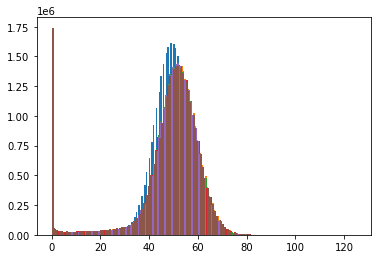

In [10]:
arr_avg_cov=calculate_avg_thr('/Users/linnbeckman/OneDrive/Uppsala Universitet_OneDrive/project_bioinf/Simulated_data/30mil_sim_50')

In [11]:
print(arr_avg_cov)

[array([48.65333333]), array([51.58666667]), array([51.36666667]), array([51.66666667]), array([51.59333333]), array([51.33333333])]


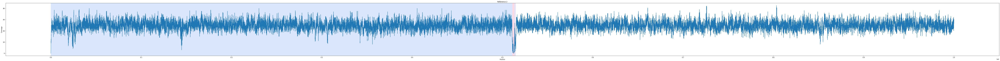

Sample:3, running time: 
7.072105169296265


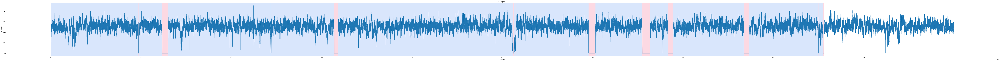

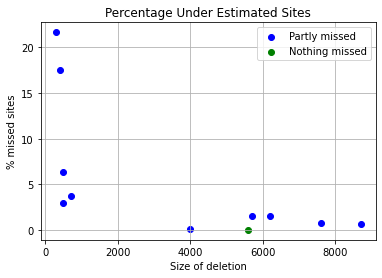

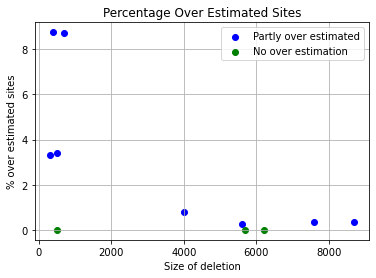

accuracy, sensitivity, specificity
(0.999136, 0.9872636815920398, 0.9996332569285268)
Sample:4, running time: 
7.124140739440918


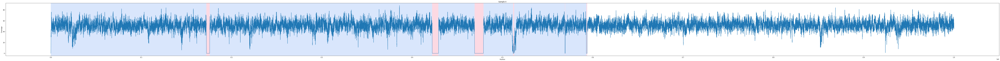

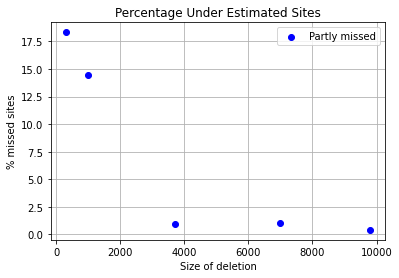

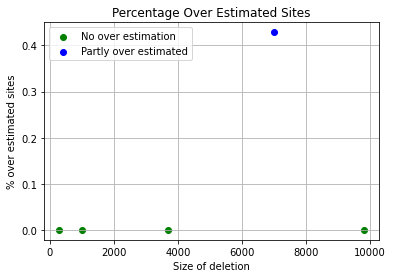

accuracy, sensitivity, specificity
(0.999505, 0.9841743119266055, 0.9998466571253323)
Sample:5, running time: 
7.194933891296387


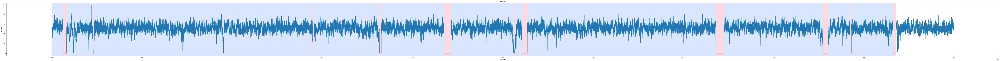

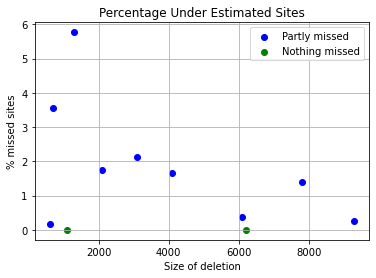

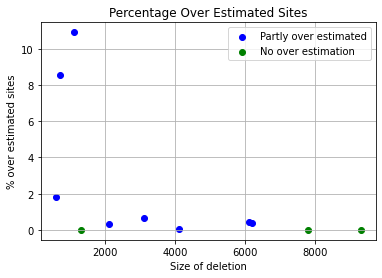

accuracy, sensitivity, specificity
(0.999295, 0.9898584905660377, 0.9997128237259816)
Sample:6, running time: 
7.0802178382873535


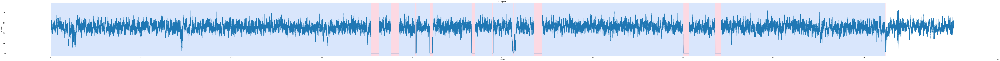

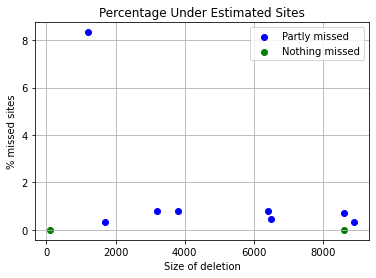

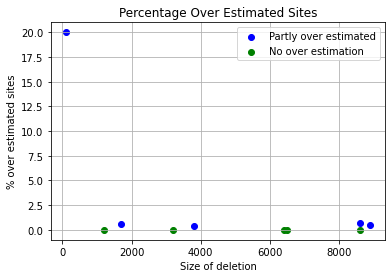

accuracy, sensitivity, specificity
(0.998173, 0.9932448979591837, 0.9984269190325973)
Sample:7, running time: 
7.235759735107422


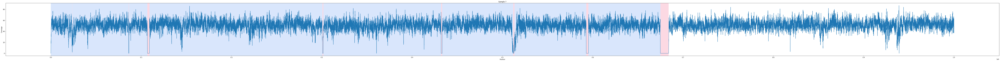

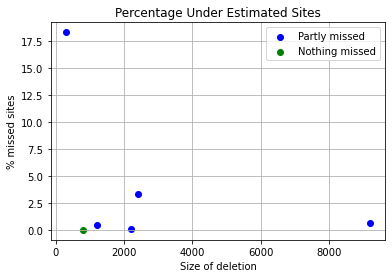

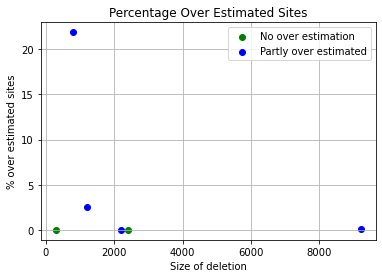

accuracy, sensitivity, specificity
(0.999466, 0.9877639751552795, 0.9996574855168208)


In [12]:
predict_deletions_bottomUp(path, "PA_chr01", 10**4, 10**4, arr_avg_cov,[2], "bu_p10e4")


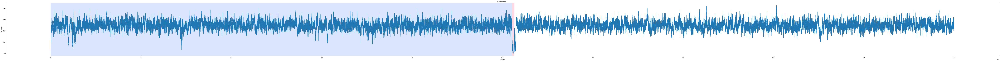

Sample:3, running time: 
7.255713939666748


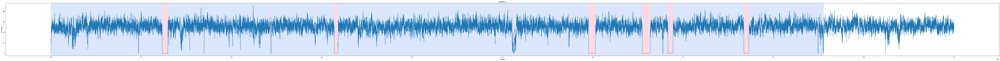

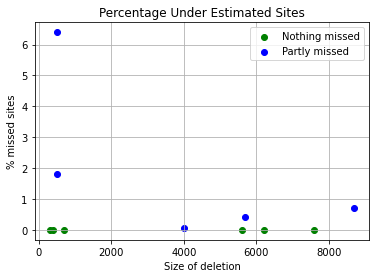

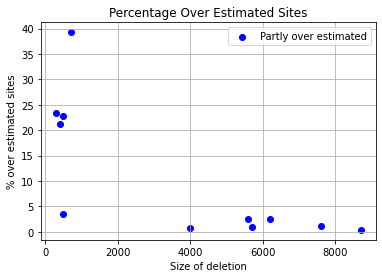

accuracy, sensitivity, specificity
(0.998811, 0.9968407960199005, 0.9988935194832257)
Sample:4, running time: 
7.265351295471191


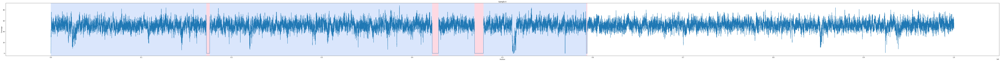

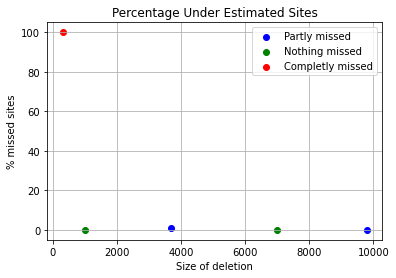

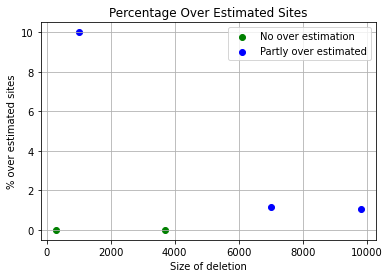

accuracy, sensitivity, specificity
(0.99936, 0.9837155963302753, 0.9997086485381312)
Sample:5, running time: 
7.399399995803833


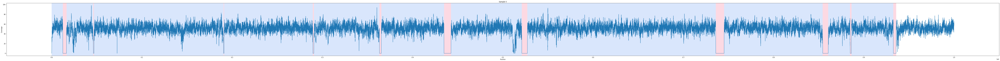

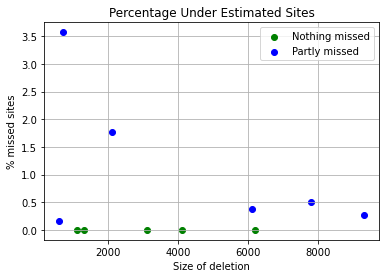

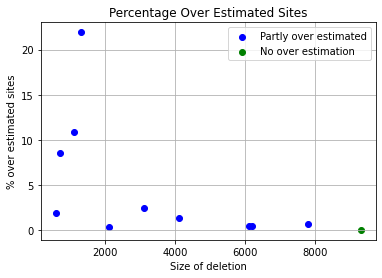

accuracy, sensitivity, specificity
(0.999135, 0.9964622641509434, 0.9992533416875522)
Sample:6, running time: 
7.43685507774353


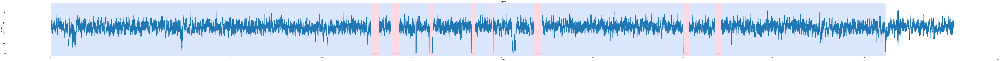

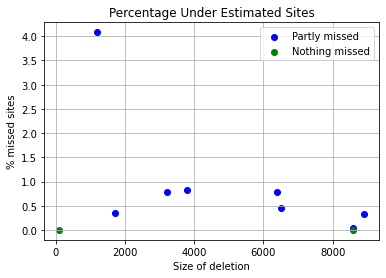

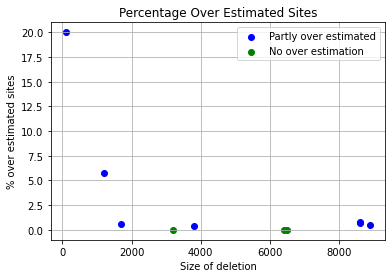

accuracy, sensitivity, specificity
(0.999369, 0.9954489795918368, 0.9995709779179811)
Sample:7, running time: 
7.444845676422119


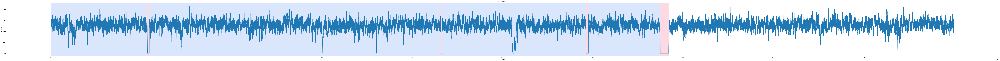

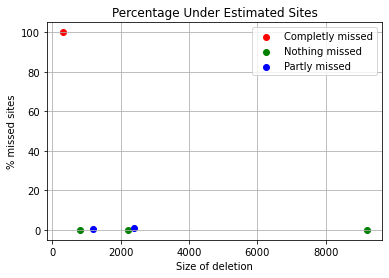

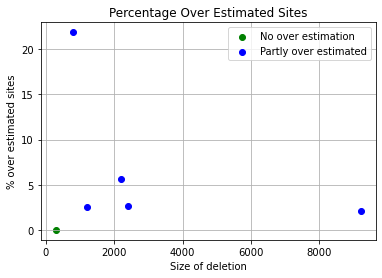

accuracy, sensitivity, specificity
(0.999082, 0.9795652173913043, 0.9994013619270251)


In [13]:
predict_deletions_bottomUp(path, "PA_chr01", 10**5, 10**5, arr_avg_cov,[2], "bu_p10e5")


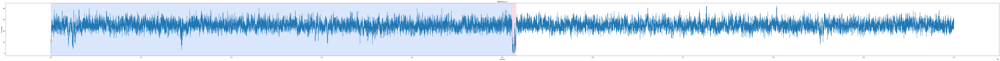

Sample:3, running time: 
7.194157838821411


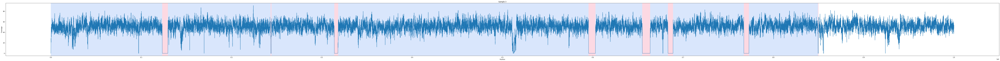

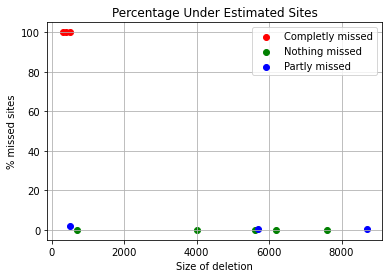

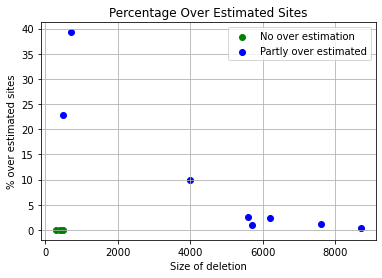

accuracy, sensitivity, specificity
(0.997454, 0.9678358208955223, 0.9986945196916024)
Sample:4, running time: 
7.326777935028076


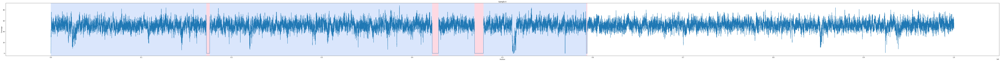

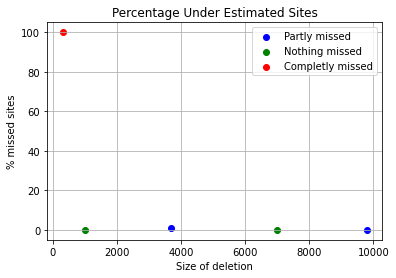

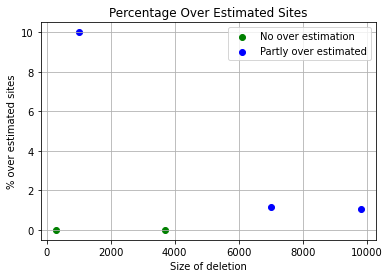

accuracy, sensitivity, specificity
(0.99936, 0.9837155963302753, 0.9997086485381312)
Sample:5, running time: 
7.693972826004028


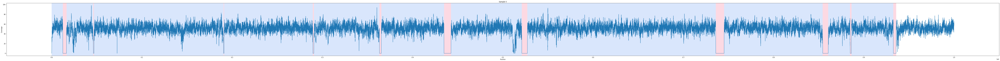

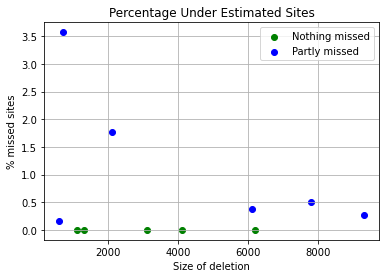

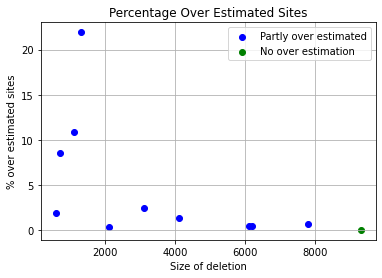

accuracy, sensitivity, specificity
(0.999135, 0.9964622641509434, 0.9992533416875522)
Sample:6, running time: 
8.212111949920654


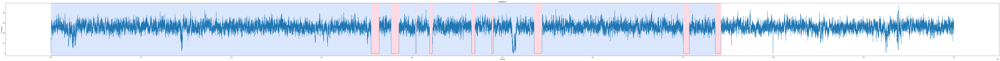

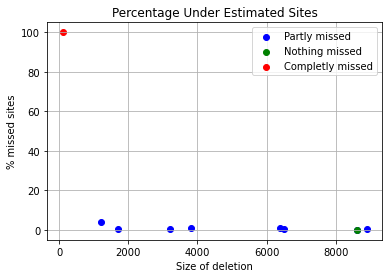

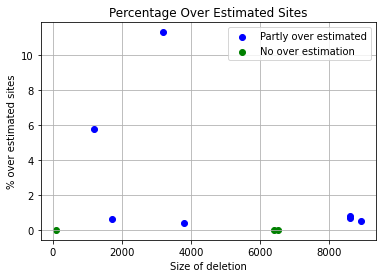

accuracy, sensitivity, specificity
(0.99905, 0.9934693877551021, 0.9993375394321766)
Sample:7, running time: 
7.2361159324646


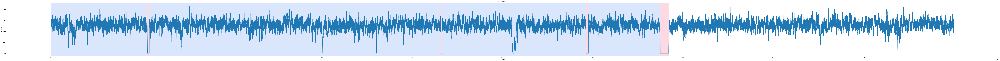

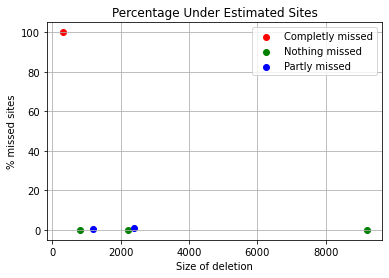

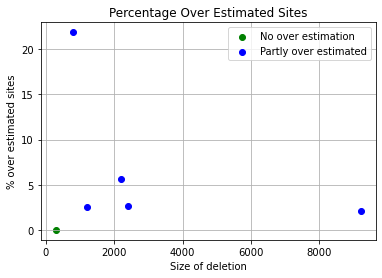

accuracy, sensitivity, specificity
(0.999082, 0.9795652173913043, 0.9994013619270251)


In [14]:
predict_deletions_bottomUp(path, "PA_chr01", 10**6, 10**6, arr_avg_cov,[2], "bu_p10e6")


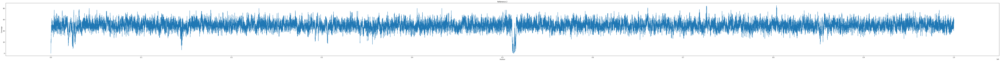

[38.69]
Sample:3, running time: 
12.272747993469238


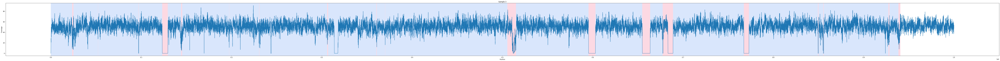

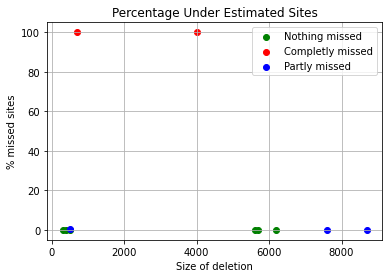

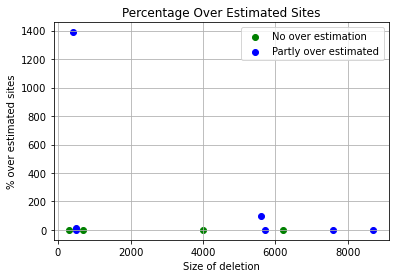

accuracy, sensitivity, specificity
(0.97204, 0.8829601990049751, 0.9757709939570743)
[38.525]
Sample:4, running time: 
13.527040958404541


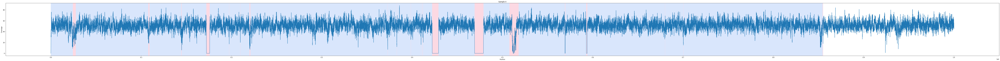

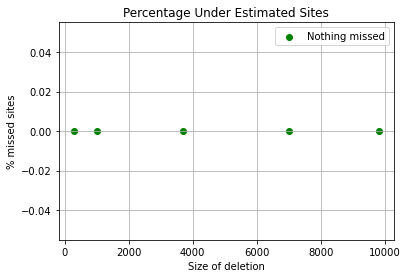

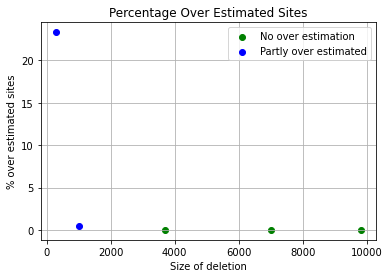

accuracy, sensitivity, specificity
(0.98169, 1.0, 0.9812819464322224)
[38.75]
Sample:5, running time: 
11.236857891082764


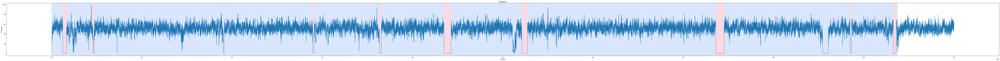

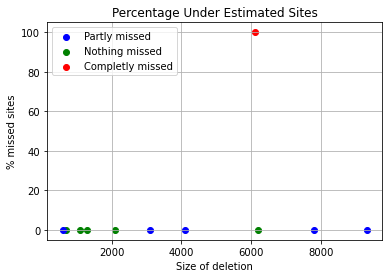

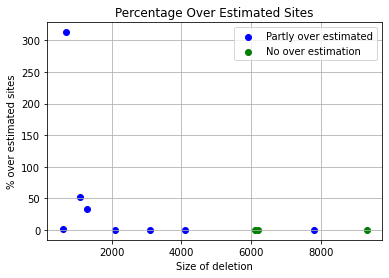

accuracy, sensitivity, specificity
(0.98953, 0.8558962264150943, 0.9954469507101086)
[38.695]
Sample:6, running time: 
11.153556108474731


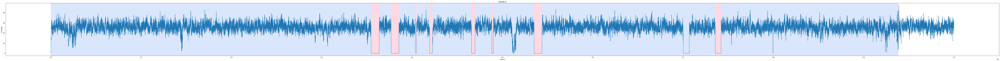

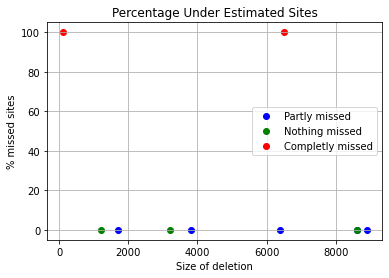

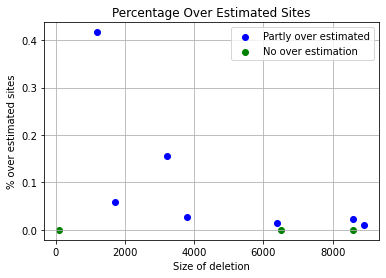

accuracy, sensitivity, specificity
(0.992483, 0.8651836734693877, 0.9990420609884332)
[38.5]
Sample:7, running time: 
11.204629898071289


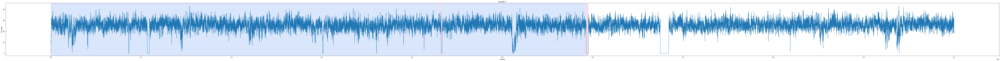

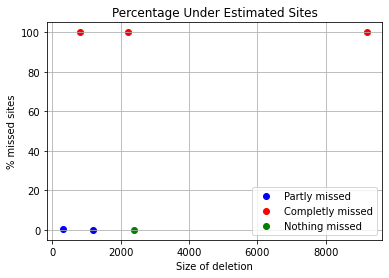

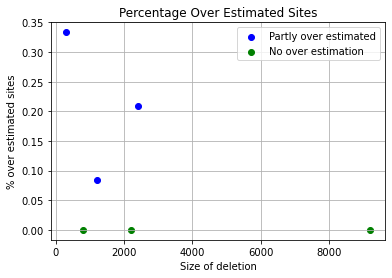

accuracy, sensitivity, specificity
(0.987791, 0.24211180124223602, 0.999992885455839)


In [15]:
predict_deletions_window(path, "PA_chr01", 1, 1, 50, arr_avg_cov,[2], "w_p1w50")


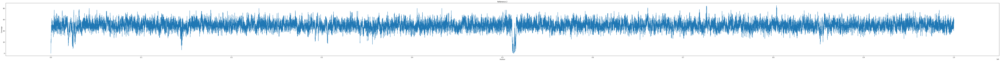

[38.69]
Sample:3, running time: 
11.650212049484253


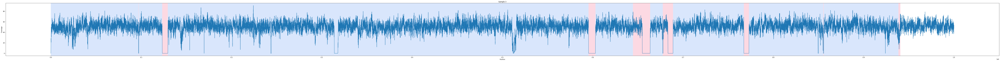

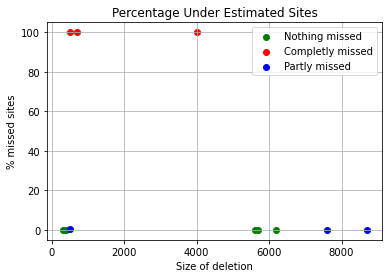

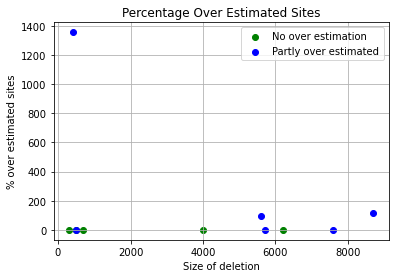

accuracy, sensitivity, specificity
(0.97692, 0.8705223880597015, 0.9813763284017504)
[38.525]
Sample:4, running time: 
14.304900646209717


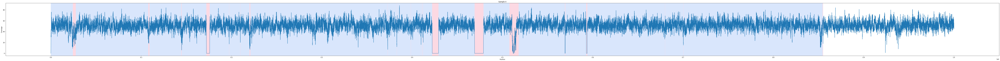

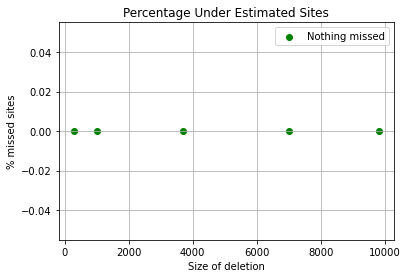

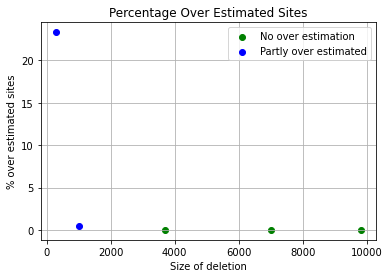

accuracy, sensitivity, specificity
(0.98169, 1.0, 0.9812819464322224)
[38.75]
Sample:5, running time: 
11.513410806655884


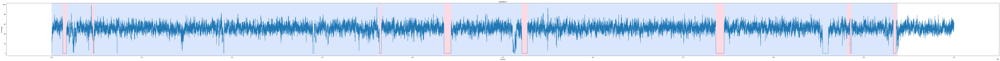

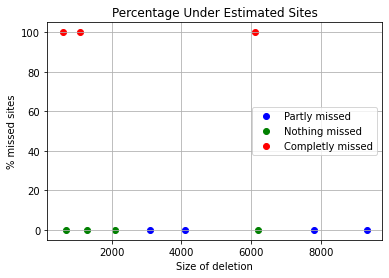

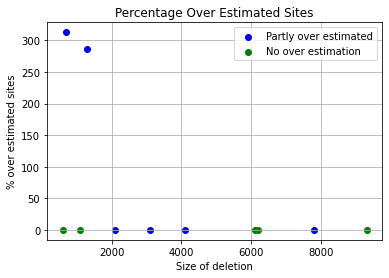

accuracy, sensitivity, specificity
(0.985437, 0.8158254716981133, 0.9929469507101086)
[38.695]
Sample:6, running time: 
11.81162405014038


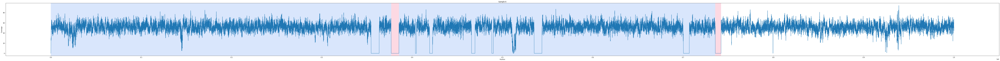

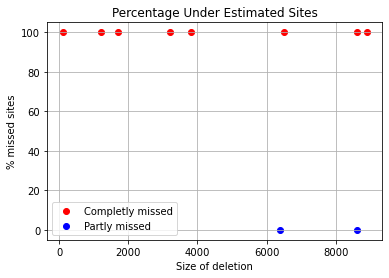

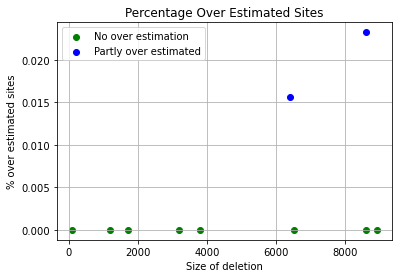

accuracy, sensitivity, specificity
(0.965994, 0.3060612244897959, 0.9999968454258675)
[38.5]
Sample:7, running time: 
11.205312013626099


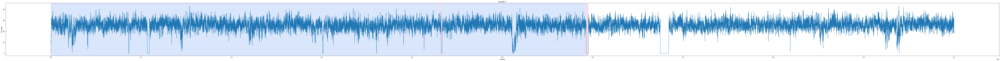

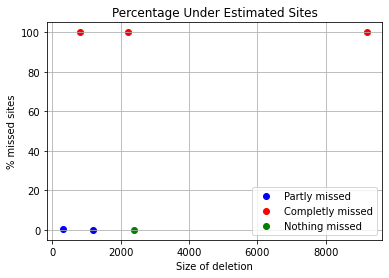

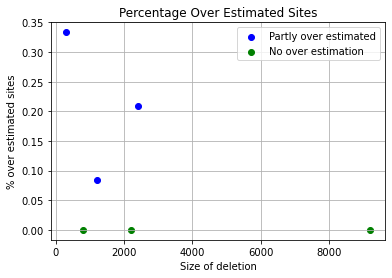

accuracy, sensitivity, specificity
(0.987791, 0.24211180124223602, 0.999992885455839)


In [16]:
predict_deletions_window(path, "PA_chr01", 5, 5, 50, arr_avg_cov,[2], "w_p5w50")


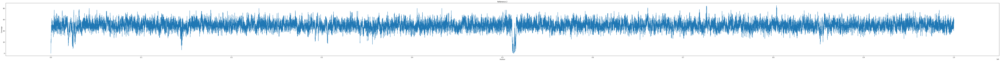

[38.69]
Sample:3, running time: 
12.517427206039429


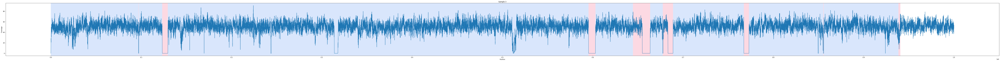

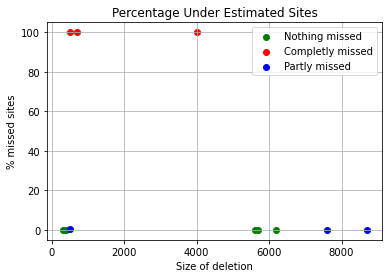

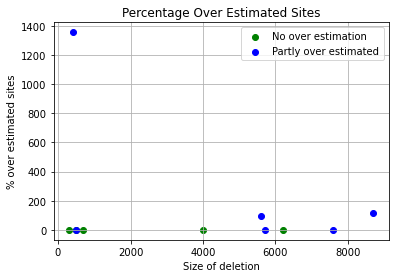

accuracy, sensitivity, specificity
(0.97692, 0.8705223880597015, 0.9813763284017504)
[38.525]
Sample:4, running time: 
15.401190042495728


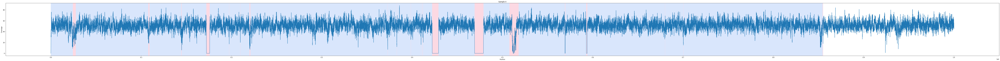

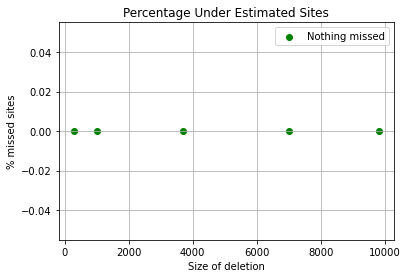

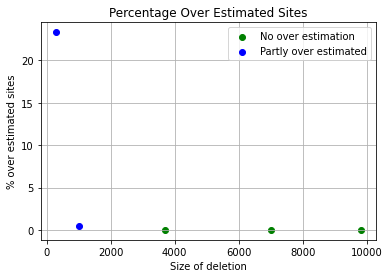

accuracy, sensitivity, specificity
(0.98169, 1.0, 0.9812819464322224)
[38.75]
Sample:5, running time: 
12.222221851348877


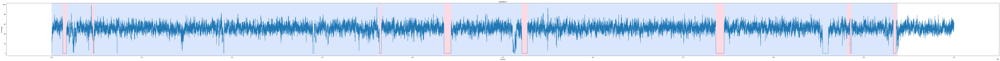

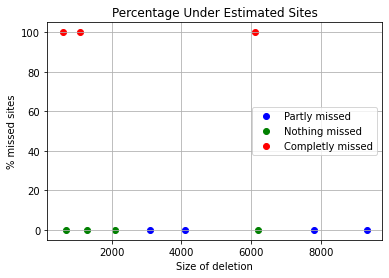

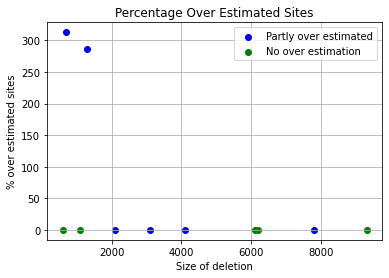

accuracy, sensitivity, specificity
(0.985437, 0.8158254716981133, 0.9929469507101086)
[38.695]
Sample:6, running time: 
12.263365983963013


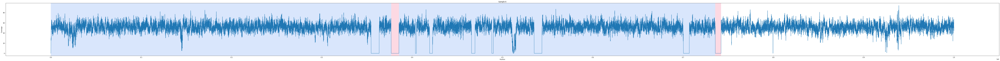

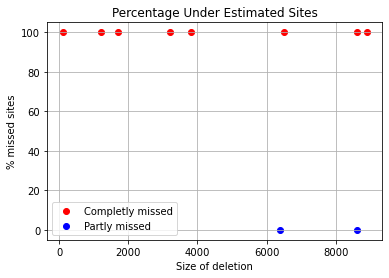

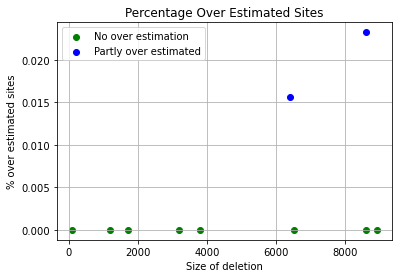

accuracy, sensitivity, specificity
(0.965994, 0.3060612244897959, 0.9999968454258675)
[38.5]
Sample:7, running time: 
11.868648052215576


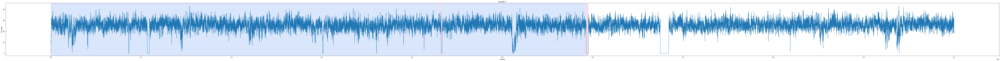

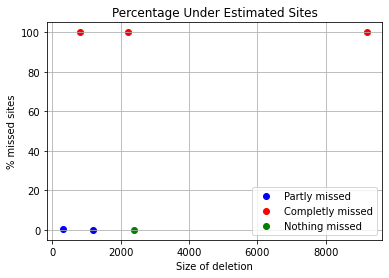

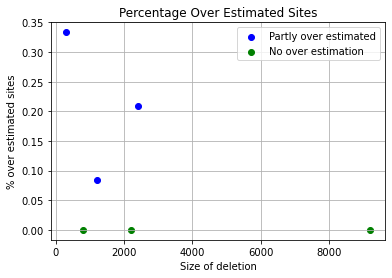

accuracy, sensitivity, specificity
(0.987791, 0.24211180124223602, 0.999992885455839)


In [17]:
predict_deletions_window(path, "PA_chr01", 10, 10, 50, arr_avg_cov,[2], "w_p10w50")


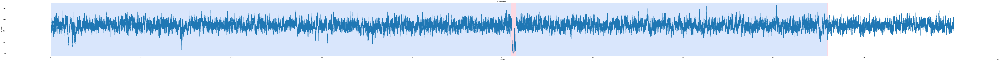

[38.69]
Sample:3, running time: 
11.84220004081726


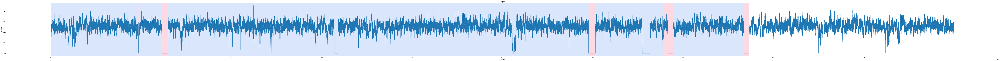

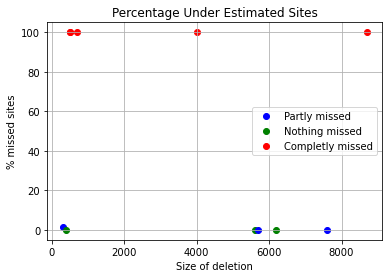

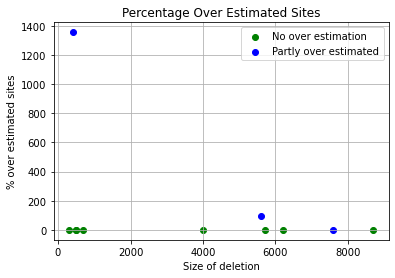

accuracy, sensitivity, specificity
(0.980163, 0.6415174129353234, 0.9943467389039383)
[38.525]
Sample:4, running time: 
17.944034814834595


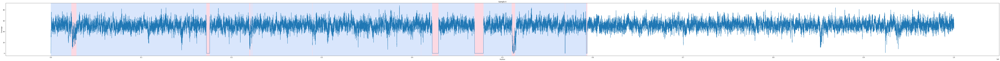

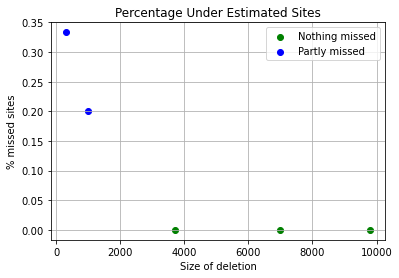

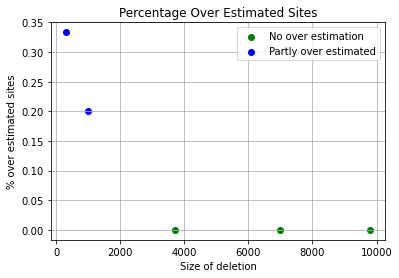

accuracy, sensitivity, specificity
(0.992224, 0.9998623853211009, 0.9920537722347168)
[38.75]
Sample:5, running time: 
11.726646184921265


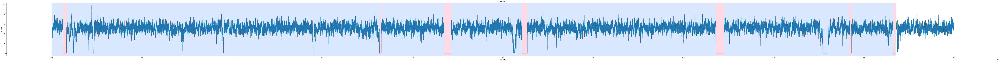

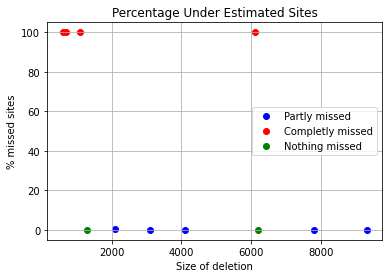

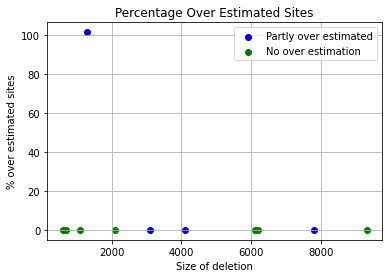

accuracy, sensitivity, specificity
(0.990162, 0.7991981132075472, 0.9986173767752715)
[38.695]
Sample:6, running time: 
13.14460015296936


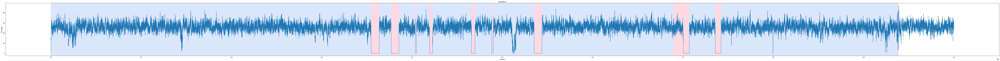

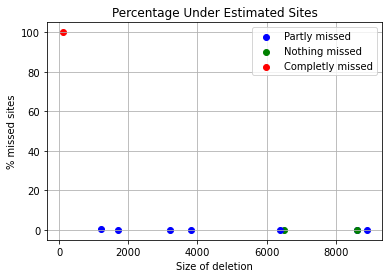

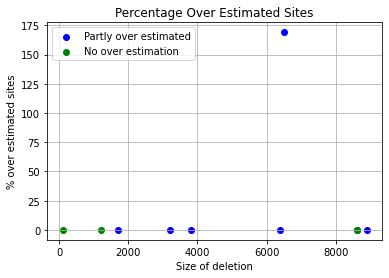

accuracy, sensitivity, specificity
(0.987809, 0.9976938775510205, 0.9872996845425868)
[38.5]
Sample:7, running time: 
11.84686279296875


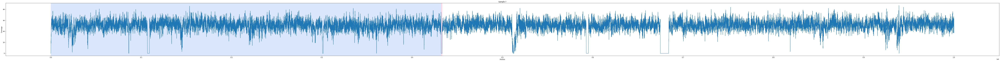

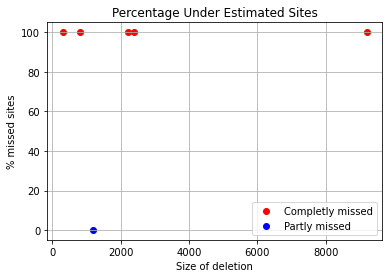

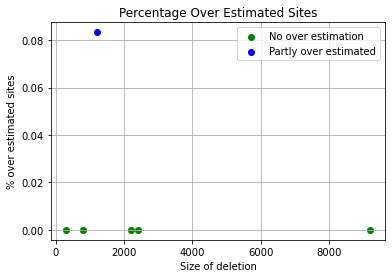

accuracy, sensitivity, specificity
(0.985098, 0.07447204968944099, 0.9999989836365484)


In [18]:
predict_deletions_window(path, "PA_chr01", 1, 1, 10, arr_avg_cov,[2], "w_p1w10")


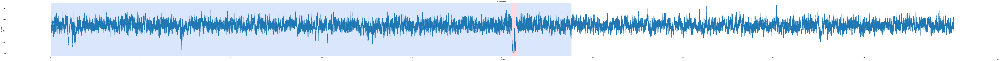

[38.69]
Sample:3, running time: 
11.529631853103638


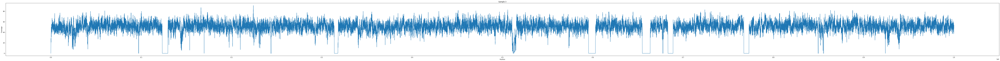

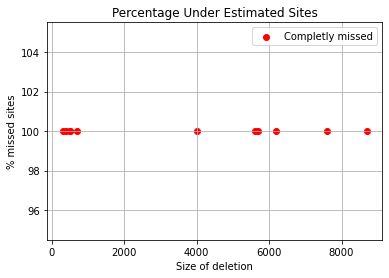

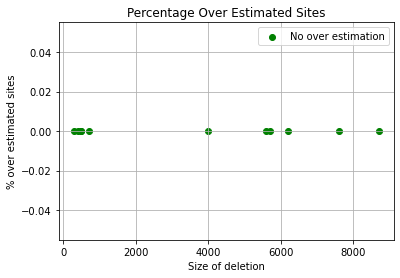

accuracy, sensitivity, specificity
(0.9598, 0.0, 1.0)
[38.525]
Sample:4, running time: 
12.989853858947754


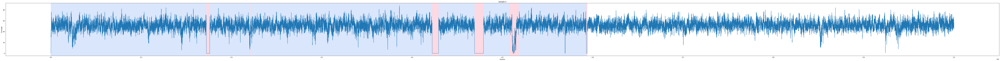

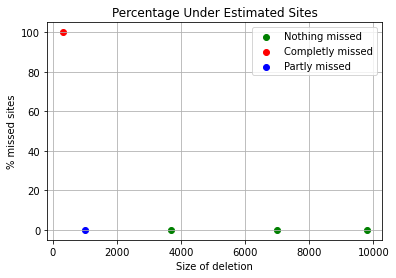

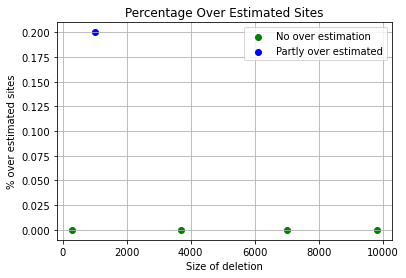

accuracy, sensitivity, specificity
(0.988276, 0.9861467889908256, 0.9883234512369659)
[38.75]
Sample:5, running time: 
11.964308023452759


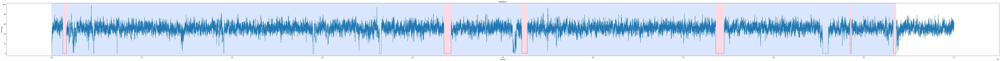

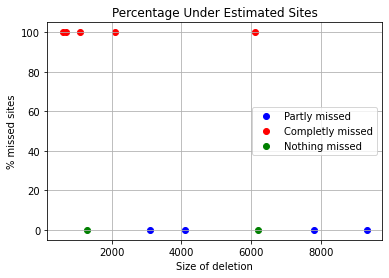

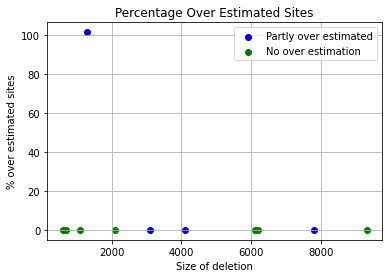

accuracy, sensitivity, specificity
(0.988067, 0.7497877358490566, 0.9986173767752715)
[38.695]
Sample:6, running time: 
13.186001062393188


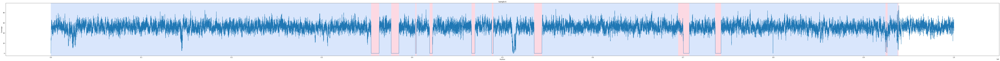

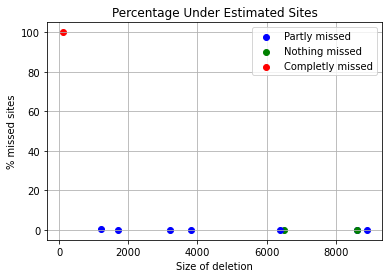

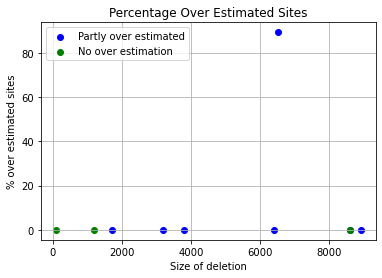

accuracy, sensitivity, specificity
(0.990819, 0.9976938775510205, 0.9904647739221871)
[38.5]
Sample:7, running time: 
11.799150943756104


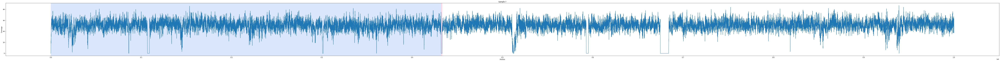

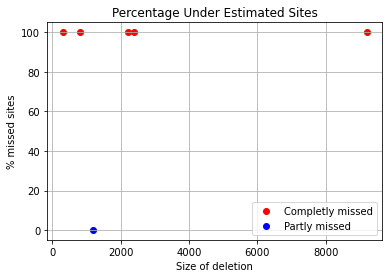

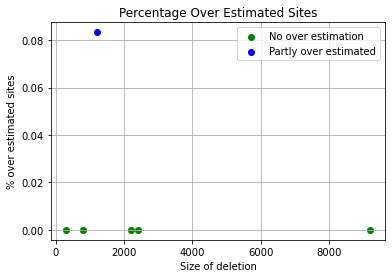

accuracy, sensitivity, specificity
(0.985098, 0.07447204968944099, 0.9999989836365484)


In [19]:
predict_deletions_window(path, "PA_chr01", 1, 1, 25, arr_avg_cov,[2], "w_p1w25")


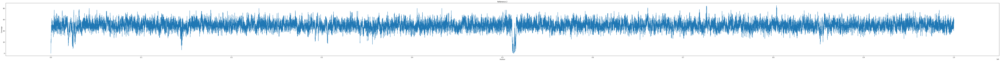

[38.69]
Sample:3, running time: 
22.391117095947266


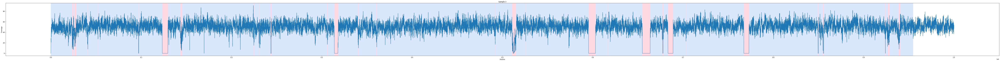

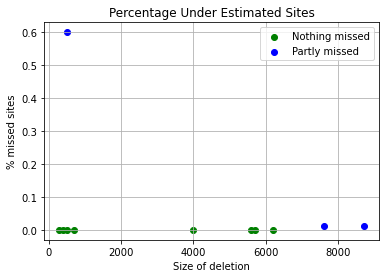

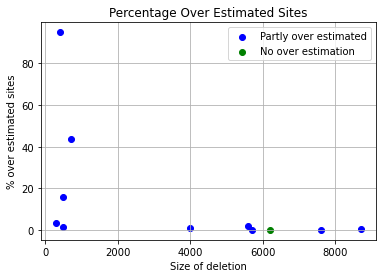

accuracy, sensitivity, specificity
(0.97808, 0.9998756218905472, 0.9771671181496145)
[38.525]
Sample:4, running time: 
12.349066019058228


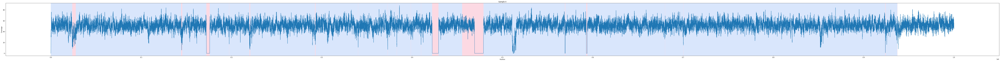

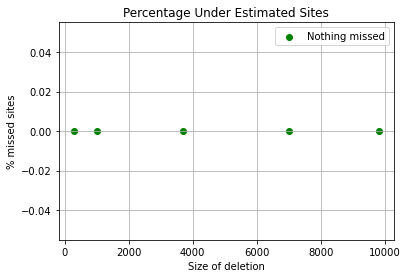

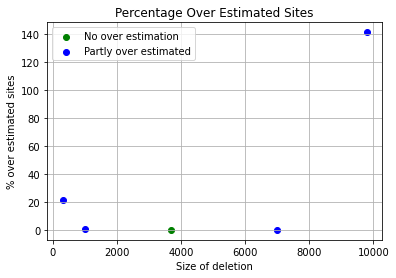

accuracy, sensitivity, specificity
(0.97777, 1.0, 0.9772745859742384)
[38.75]
Sample:5, running time: 
11.697901010513306


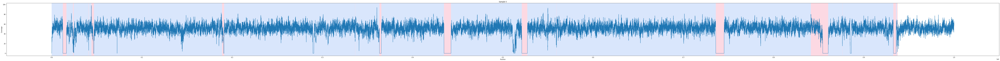

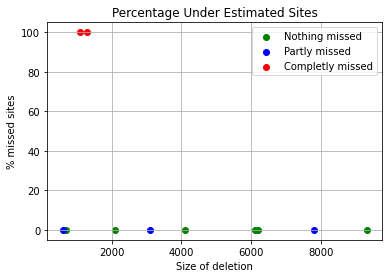

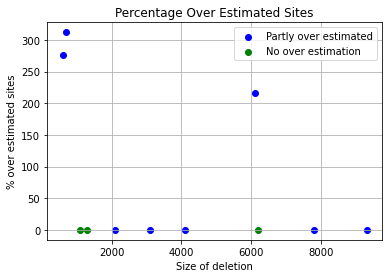

accuracy, sensitivity, specificity
(0.978414, 0.9433254716981132, 0.979967627401838)
[38.695]
Sample:6, running time: 
12.462098836898804


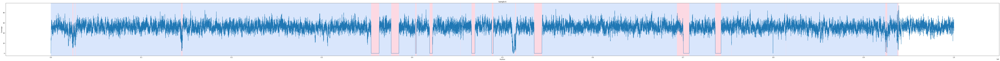

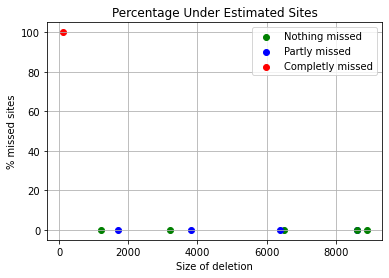

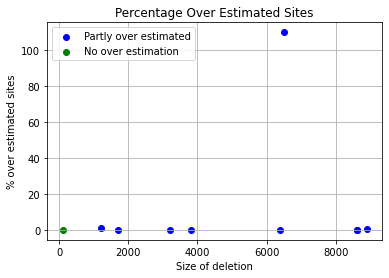

accuracy, sensitivity, specificity
(0.985655, 0.9978571428571429, 0.9850262881177708)
[38.5]
Sample:7, running time: 
12.040060997009277


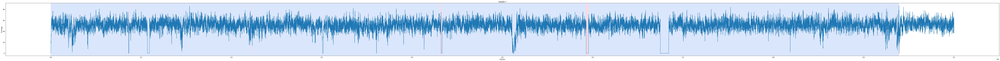

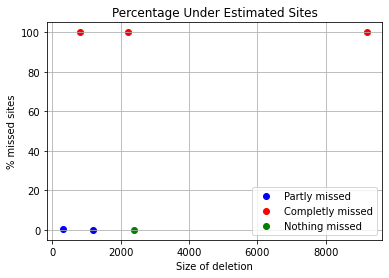

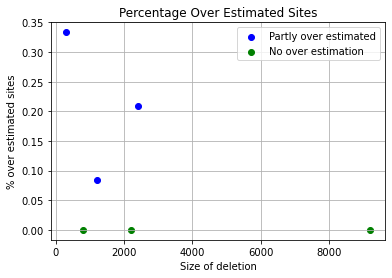

accuracy, sensitivity, specificity
(0.986991, 0.24211180124223602, 0.9991797946945827)


In [20]:
predict_deletions_window(path, "PA_chr01", 1, 1, 100, arr_avg_cov,[2], "w_p1w100")


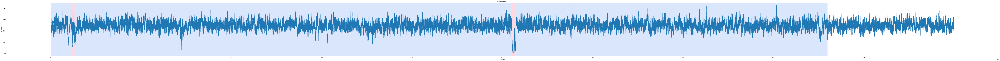

[38.69]
Sample:3, running time: 
27.012044191360474


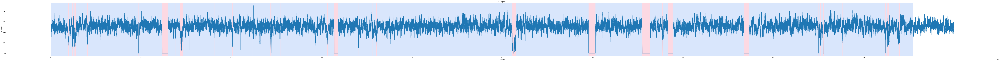

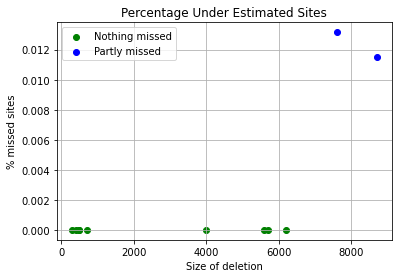

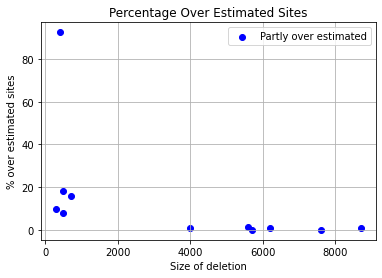

accuracy, sensitivity, specificity
(0.977856, 0.9999502487562189, 0.9769306105438633)
[38.525]
Sample:4, running time: 
13.293968200683594


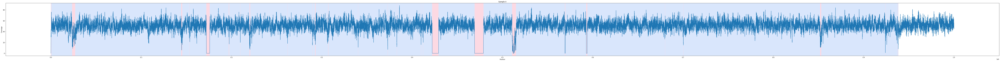

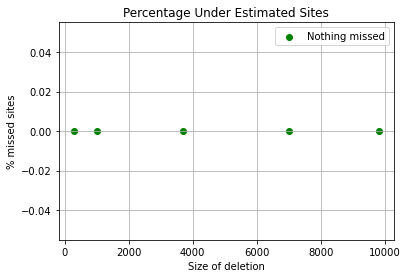

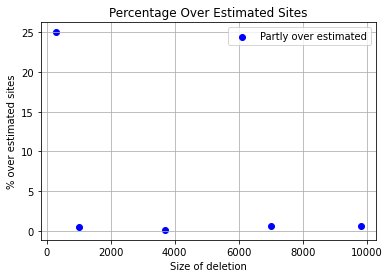

accuracy, sensitivity, specificity
(0.986485, 1.0, 0.9861838069924351)
[38.75]
Sample:5, running time: 
12.18647289276123


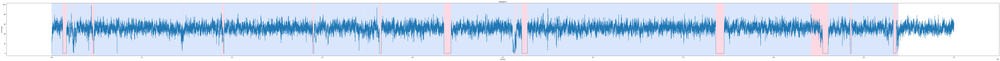

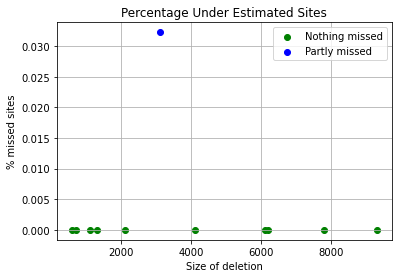

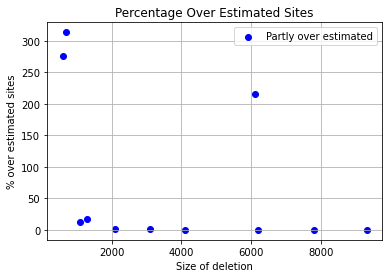

accuracy, sensitivity, specificity
(0.978188, 0.9999764150943397, 0.9772232664995822)
[38.695]
Sample:6, running time: 
17.692440032958984


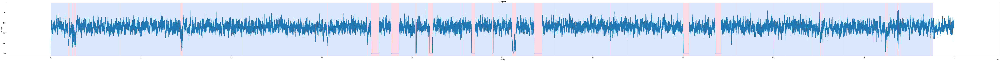

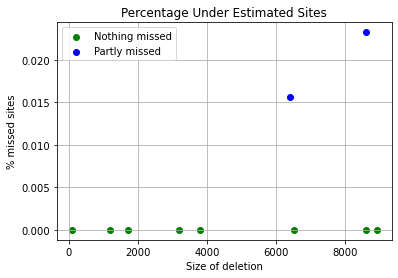

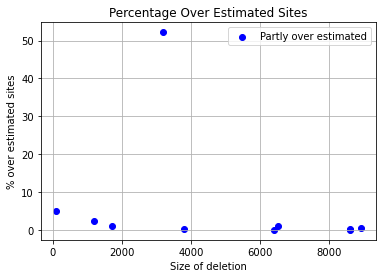

accuracy, sensitivity, specificity
(0.978414, 0.999938775510204, 0.9773049421661409)
[38.5]
Sample:7, running time: 
12.510859966278076


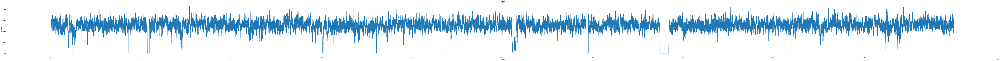

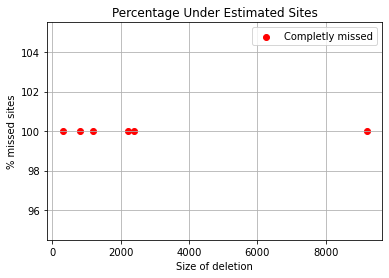

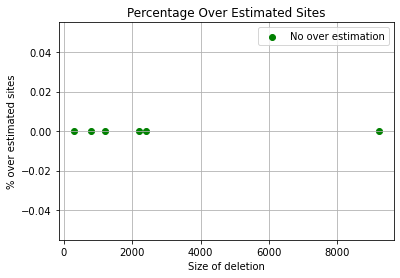

accuracy, sensitivity, specificity
(0.9839, 0.0, 1.0)


In [21]:
predict_deletions_window(path, "PA_chr01", 1, 1, 200, arr_avg_cov,[2], "w_p1w200")

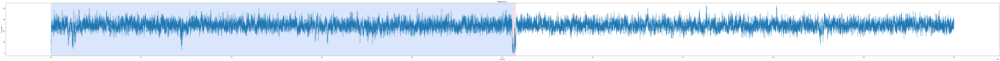

[7.738]
Sample:3, running time: 
24.03040885925293


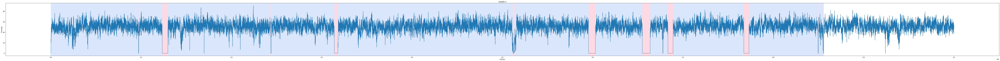

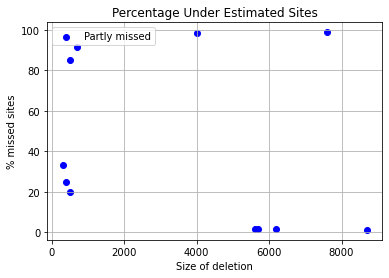

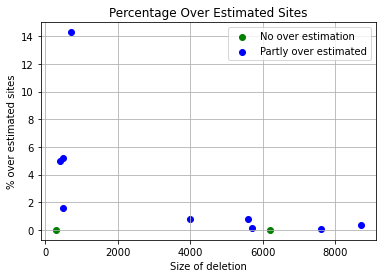

accuracy, sensitivity, specificity
(0.997848, 0.9906467661691543, 0.9981496145030214)
[7.705]
Sample:4, running time: 
19.916095972061157


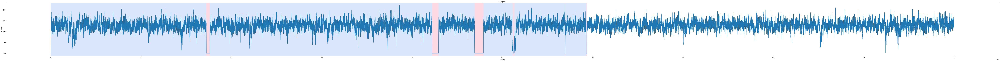

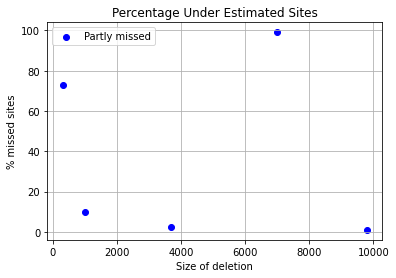

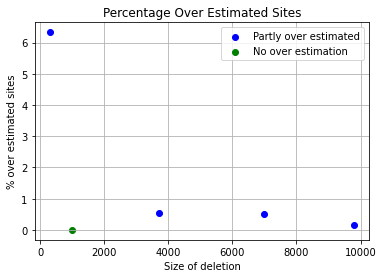

accuracy, sensitivity, specificity
(0.998122, 0.9913302752293578, 0.998273359231241)
[7.75]
Sample:5, running time: 
24.45686388015747


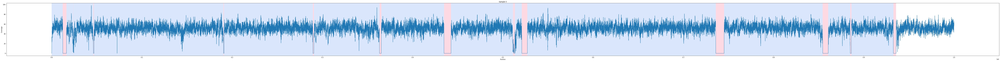

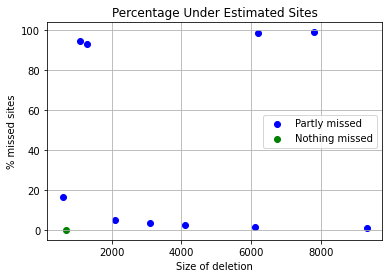

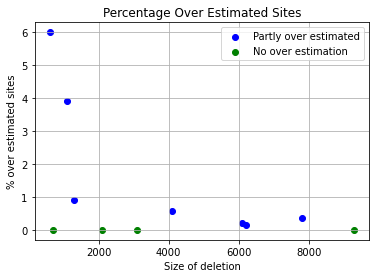

accuracy, sensitivity, specificity
(0.997768, 0.9890094339622642, 0.998155806182122)
[7.739]
Sample:6, running time: 
25.63233709335327


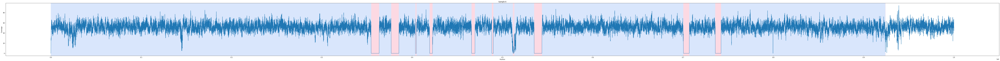

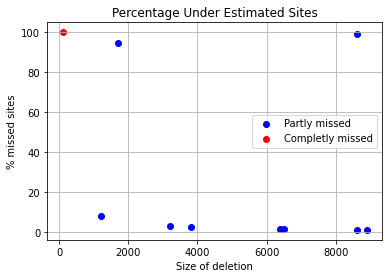

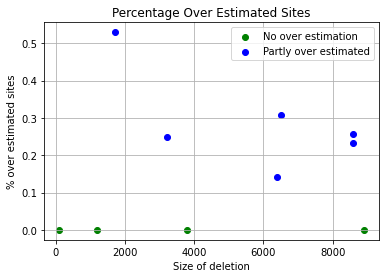

accuracy, sensitivity, specificity
(0.998024, 0.9900408163265306, 0.9984353312302839)
[7.7]
Sample:7, running time: 
20.606137990951538


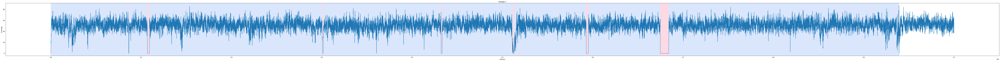

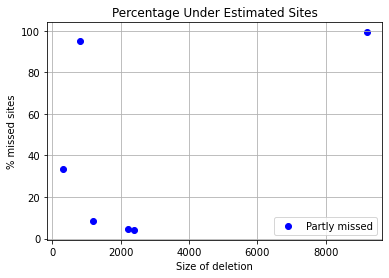

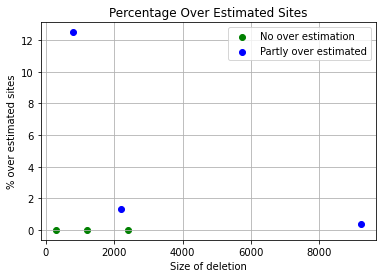

accuracy, sensitivity, specificity
(0.997772, 0.9773913043478261, 0.998105498526273)


In [22]:
predict_deletions_pelt(path, "PA_chr01", 100, 100, 100, arr_avg_cov,[2], "pelt_p100")

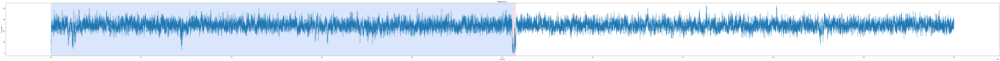

[7.738]
Sample:3, running time: 
21.279146909713745


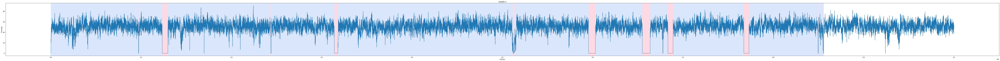

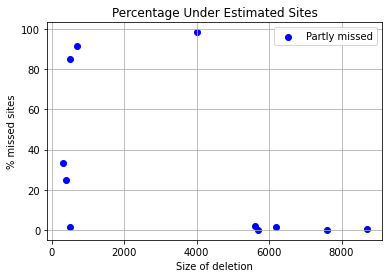

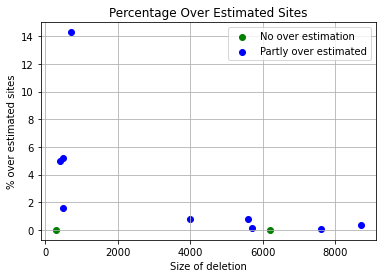

accuracy, sensitivity, specificity
(0.997848, 0.9906467661691543, 0.9981496145030214)
[7.705]
Sample:4, running time: 
17.093222856521606


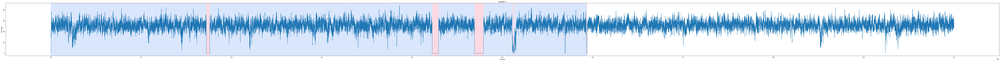

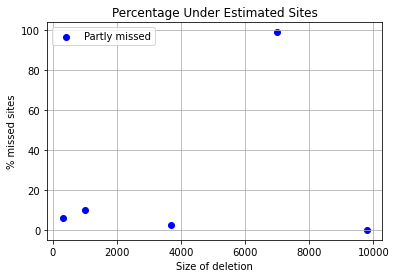

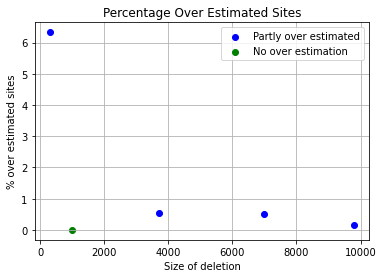

accuracy, sensitivity, specificity
(0.998222, 0.9913302752293578, 0.9983755878143529)
[7.75]
Sample:5, running time: 
20.36600399017334


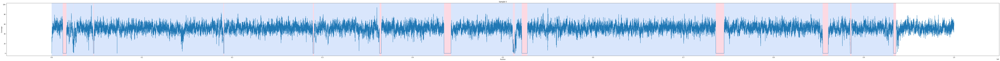

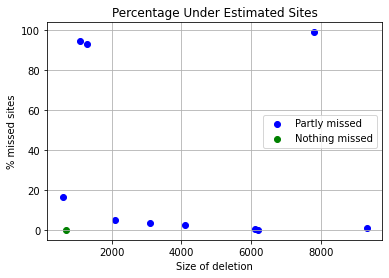

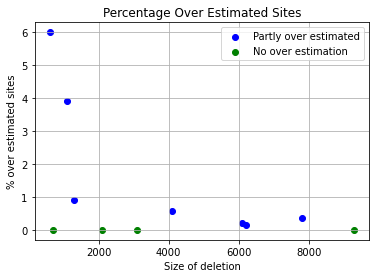

accuracy, sensitivity, specificity
(0.998368, 0.9890094339622642, 0.998782372598162)
[7.739]
Sample:6, running time: 
20.38879370689392


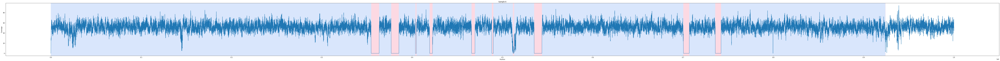

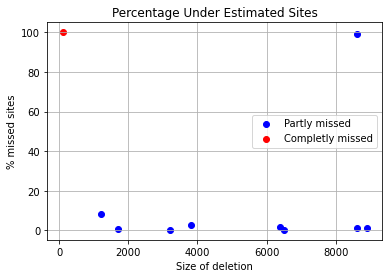

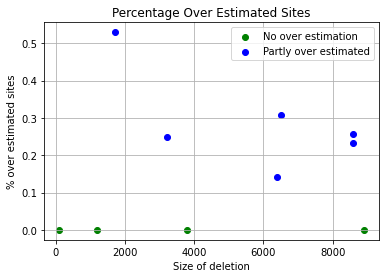

accuracy, sensitivity, specificity
(0.998124, 0.9900408163265306, 0.9985404837013669)
[7.7]
Sample:7, running time: 
17.59003710746765


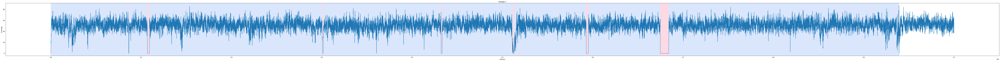

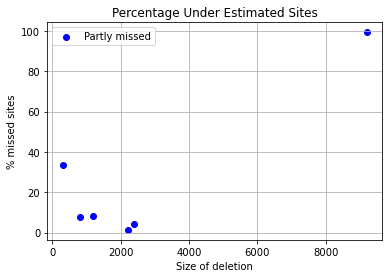

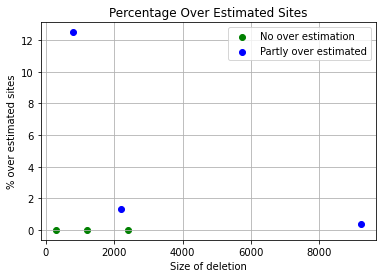

accuracy, sensitivity, specificity
(0.998672, 0.9773913043478261, 0.9990202256326862)


In [23]:
predict_deletions_pelt(path, "PA_chr01", 1000, 1000, 100, arr_avg_cov,[2], "pelt_p1000")

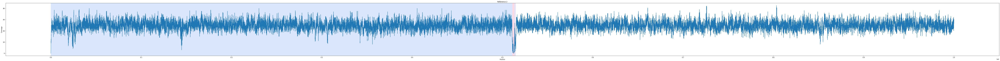

[7.738]
Sample:3, running time: 
14.034388780593872


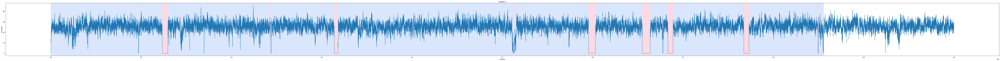

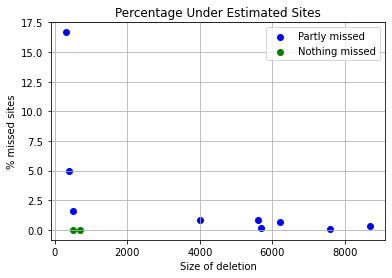

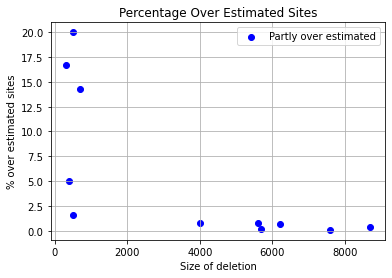

accuracy, sensitivity, specificity
(0.99932, 0.9940298507462687, 0.9995415711606584)
[7.705]
Sample:4, running time: 
13.798516035079956


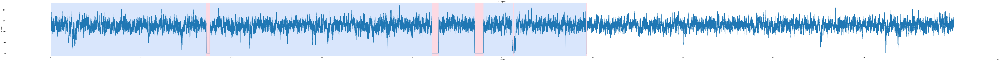

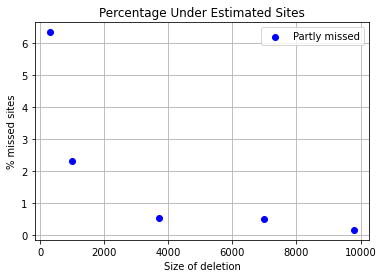

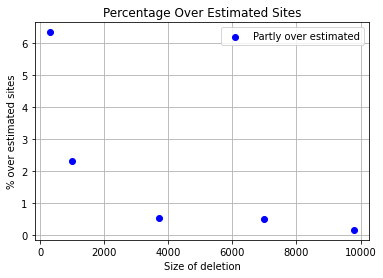

accuracy, sensitivity, specificity
(0.999776, 0.9948623853211009, 0.9998855039869148)
[7.75]
Sample:5, running time: 
13.395514011383057


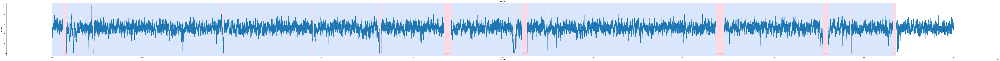

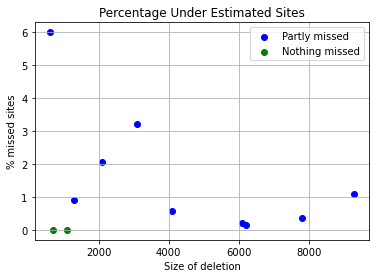

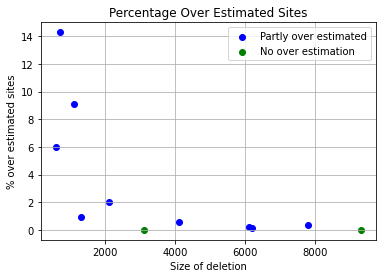

accuracy, sensitivity, specificity
(0.999268, 0.9913679245283019, 0.9996177944862156)
[7.739]
Sample:6, running time: 
14.970712900161743


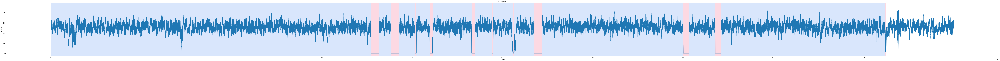

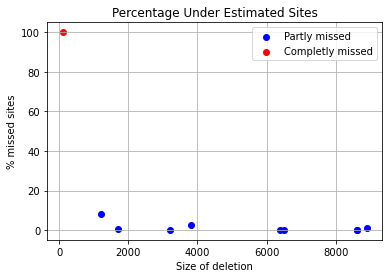

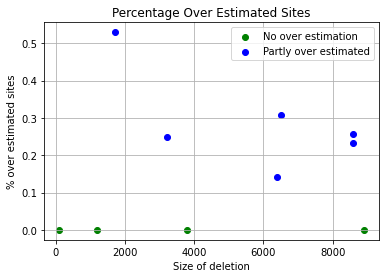

accuracy, sensitivity, specificity
(0.999324, 0.9900408163265306, 0.9998023133543639)
[7.7]
Sample:7, running time: 
15.920141696929932


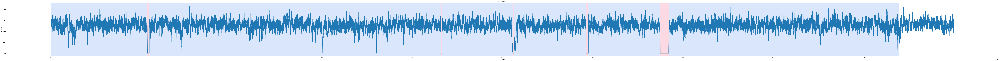

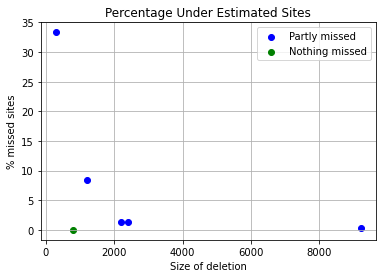

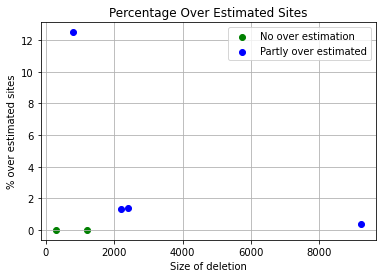

accuracy, sensitivity, specificity
(0.999306, 0.9815527950310559, 0.9995965037097266)


In [24]:
predict_deletions_pelt(path, "PA_chr01", 10000, 10000, 100, arr_avg_cov,[2], "pelt_p10000")

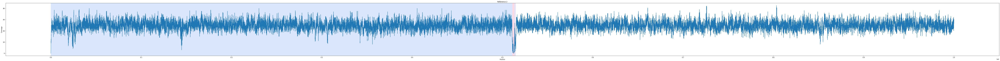

[7.738]
Sample:3, running time: 
14.193310976028442


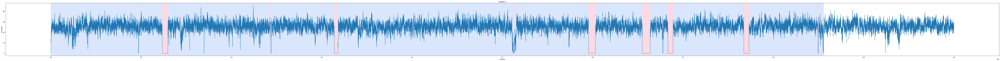

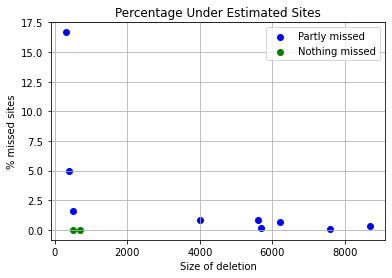

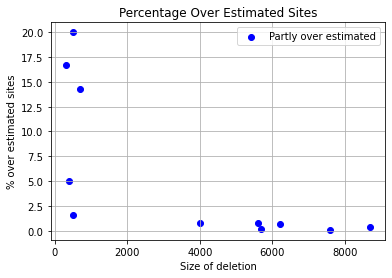

accuracy, sensitivity, specificity
(0.99932, 0.9940298507462687, 0.9995415711606584)
[7.705]
Sample:4, running time: 
14.235157012939453


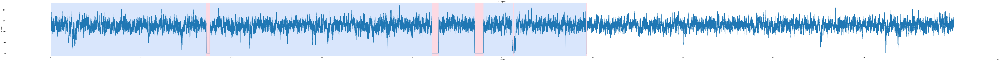

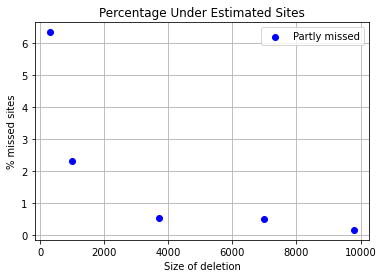

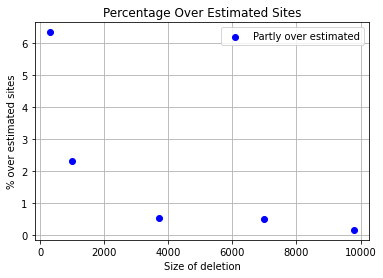

accuracy, sensitivity, specificity
(0.999776, 0.9948623853211009, 0.9998855039869148)
[7.75]
Sample:5, running time: 
14.20920181274414


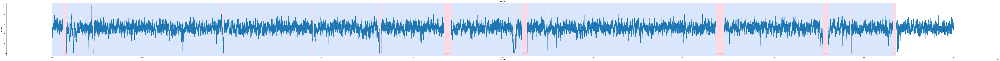

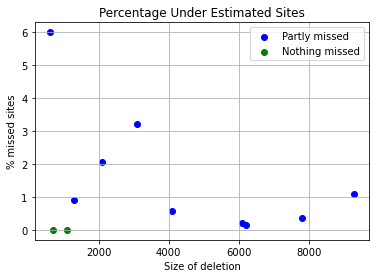

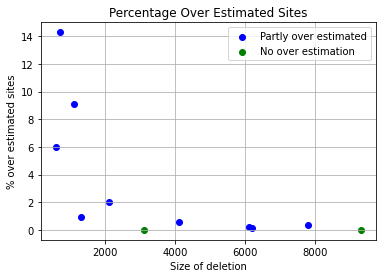

accuracy, sensitivity, specificity
(0.999268, 0.9913679245283019, 0.9996177944862156)
[7.739]
Sample:6, running time: 
14.321339130401611


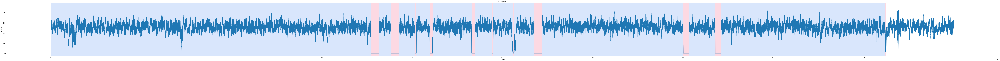

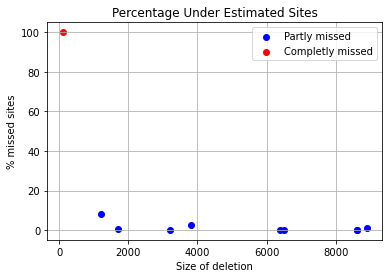

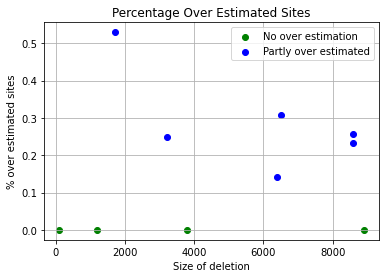

accuracy, sensitivity, specificity
(0.999324, 0.9900408163265306, 0.9998023133543639)
[7.7]
Sample:7, running time: 
14.87869381904602


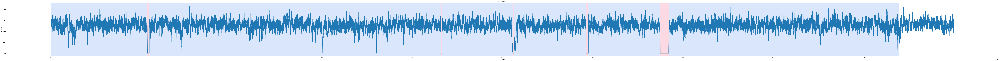

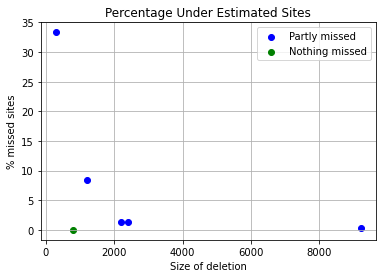

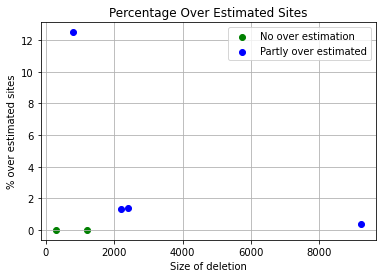

accuracy, sensitivity, specificity
(0.999306, 0.9815527950310559, 0.9995965037097266)


In [25]:
predict_deletions_pelt(path, "PA_chr01", 10**4, 10**4, 100, arr_avg_cov,[2], "pelt_p10e4")

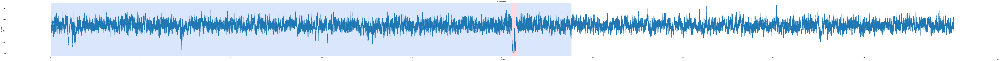

[38.69]
Sample:3, running time: 
11.550857067108154


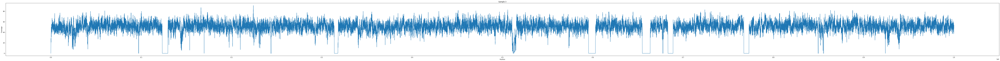

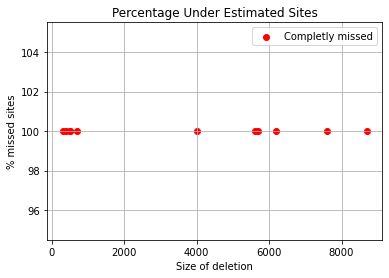

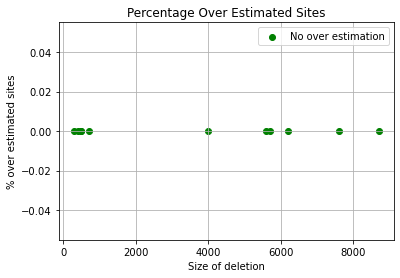

accuracy, sensitivity, specificity
(0.9598, 0.0, 1.0)
[38.525]
Sample:4, running time: 
12.965358018875122


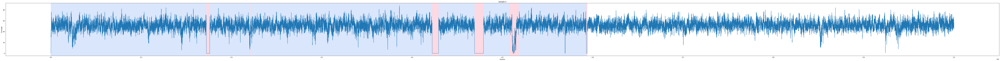

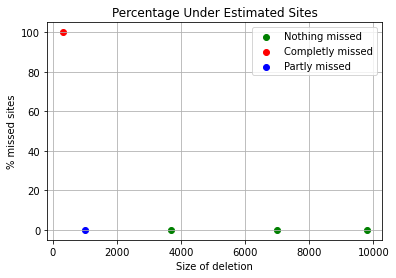

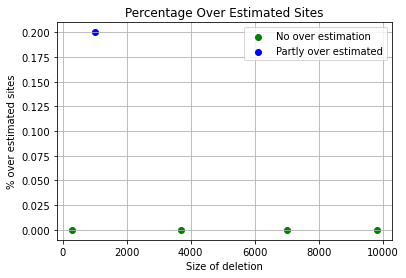

accuracy, sensitivity, specificity
(0.988276, 0.9861467889908256, 0.9883234512369659)
[38.75]
Sample:5, running time: 
12.545624017715454


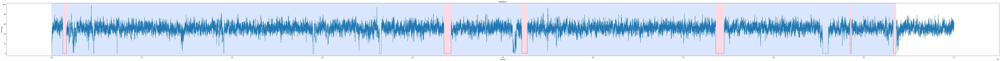

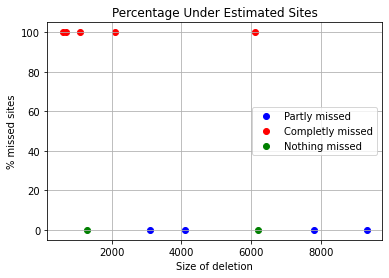

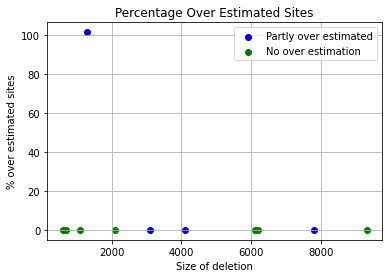

accuracy, sensitivity, specificity
(0.988067, 0.7497877358490566, 0.9986173767752715)
[38.695]
Sample:6, running time: 
14.098564147949219


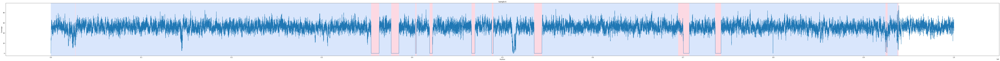

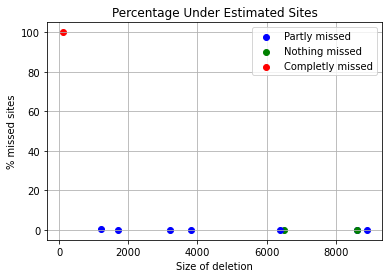

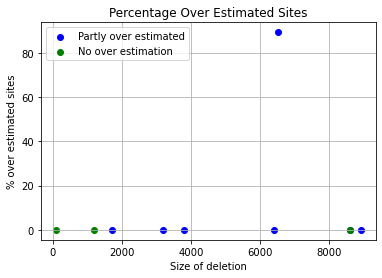

accuracy, sensitivity, specificity
(0.990154, 0.9976938775510205, 0.9897655099894848)
[38.5]
Sample:7, running time: 
12.693889856338501


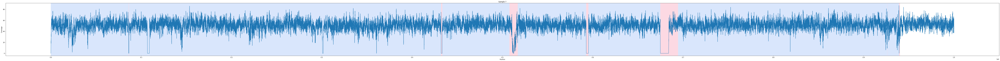

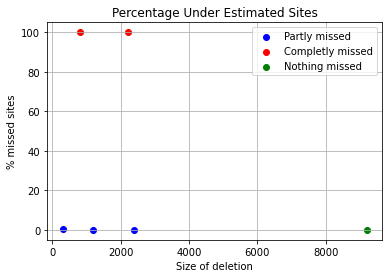

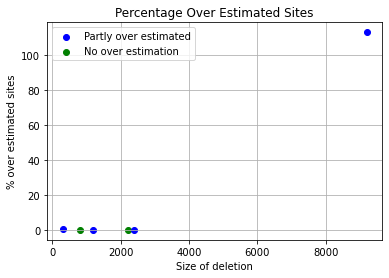

accuracy, sensitivity, specificity
(0.985287, 0.8134161490683229, 0.9880994003455635)


In [26]:
predict_deletions_window(path, "PA_chr01", 0.5, 0.5, 25, arr_avg_cov,[2], "w_p05")